In [43]:
# EDA
import pandas as pd
import pingouin as pg
import plotly.express as px
import plotly.figure_factory as ff 
import matplotlib.pyplot as plt

# Machine Learning
from sklearn.model_selection import cross_validate, StratifiedKFold, cross_val_predict, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

# Otimização de Hiperparâmetros
import optuna

# Carregando o Dataset

In [6]:
# Carregamento do dataset
df_sensores = pd.read_csv('../../dataset/sensores.csv')

In [7]:
# Mostrar 5 primeiros registros do Dataframe
df_sensores.head(5)

,Classe,ID,0,1,2,3,4,5,6,7,...,190,191,192,193,194,195,196,197,198,199
0,4,1,-0.032906,-0.037456,-0.034082,-0.001968,0.084229,0.156574,0.128887,0.042514,...,-0.036180,-0.099786,-0.080654,-0.070954,-0.003636,0.012660,0.028986,0.008340,0.065012,0.091692
1,1,1,0.198619,0.178949,0.072092,0.083383,0.151363,0.108910,-0.099102,-0.195660,...,-0.306607,-0.135897,-0.024512,0.103591,0.168580,0.032522,0.117073,0.001361,0.060746,0.093414
2,1,1,-0.000792,0.012913,0.017356,0.024251,0.022153,0.019270,0.017725,0.013644,...,0.027556,0.016042,0.014681,0.017848,0.015588,0.011422,0.008025,0.009931,0.006395,0.002775
3,2,1,-0.086419,-0.112830,-0.124875,-0.029539,-0.067434,-0.077257,0.064067,0.075505,...,0.023029,-0.032053,0.002037,0.062153,-0.033044,-0.065966,-0.102277,-0.187535,-0.140448,-0.050016
4,4,1,-0.185975,-0.066973,0.042906,0.007640,-0.038686,-0.012729,0.111408,0.104206,...,0.074705,0.114014,0.089271,0.050639,-0.007533,-0.037725,0.003866,-0.020646,-0.089609,-0.127734


In [8]:
df_sensores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221177 entries, 0 to 221176
Columns: 202 entries, Classe to 199
dtypes: float64(200), int64(2)
memory usage: 340.9 MB


# Análise Exploratória de Dados

In [12]:
# Distribuição da Variável Classe (Target)
contagem_target = df_sensores.value_counts('Classe')
contagem_target

Classe
1    44299
3    44254
5    44237
4    44204
2    44183
Name: count, dtype: int64

In [30]:
# Distribuição da Variável Target - Contagem
px.bar(contagem_target, color=contagem_target.index, category_orders={'Classe': contagem_target})


ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{marker.color}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': array([1, 3, 5, 4, 2]), 'coloraxis': 'coloraxis', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'textposition': 'auto',
              'type': 'bar',
              'x': array([1, 3, 5, 4, 2]),
              'xaxis': 'x',
              'y': array([44299, 44254, 44237, 44204, 44183]),
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'coloraxis': {'colorbar': {'title': {'text': 'Classe'}},
                             'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y',
                         'categoryarray': array([44299, 44254, 44237, 44204, 44183]),
                         'categoryorder': 'array',
                         'domain': [0.0, 1.0],
                         'title': {'text': 'Classe'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [32]:
# Distribuição da Variável Target - Percentual
percentual_target = contagem_target / len(df_sensores) * 100
px.bar(percentual_target, color=percentual_target.index, category_orders={'Classe': contagem_target})

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{marker.color}<br>value=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': array([1, 3, 5, 4, 2]), 'coloraxis': 'coloraxis', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'textposition': 'auto',
              'type': 'bar',
              'x': array([1, 3, 5, 4, 2]),
              'xaxis': 'x',
              'y': array([20.02875525, 20.00840955, 20.0007234 , 19.98580323, 19.97630857]),
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'coloraxis': {'colorbar': {'title': {'text': 'Classe'}},
                             'colorscale': [[0.0, '#0d0887'], [0.1111111111111111,
                                            '#46039f'], [0.2222222222222222,
                                            '#7201a8'], [0.3333333333333333,
                                            '#9c179e'], [0.4444444444444444,
                                            '#bd3786'], [0.5555555555555556,
                                            '#d8576b'], [0.6666666666666666,
                                            '#ed7953'], [0.7777777777777778,
                                            '#fb9f3a'], [0.8888888888888888,
                                            '#fdca26'], [1.0, '#f0f921']]},
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y',
                         'categoryarray': array([44299, 44254, 44237, 44204, 44183]),
                         'categoryorder': 'array',
                         'domain': [0.0, 1.0],
                         'title': {'text': 'Classe'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'value'}}}
})

In [35]:
# Distribuição Primeira Leitura dos Sensores
px.histogram(df_sensores, x='0')

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'bingroup': 'x',
              'hovertemplate': '0=%{x}<br>count=%{y}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa', 'pattern': {'shape': ''}},
              'name': '',
              'offsetgroup': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'histogram',
              'x': array([-3.29059220e-02,  1.98619254e-01, -7.91709873e-04, ...,  7.12941068e+01,
                           1.34690811e+02,  5.42797034e+01]),
              'xaxis': 'x',
              'yaxis': 'y'}],
    'layout': {'barmode': 'relative',
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': '0'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'count'}}}
})

In [36]:
# BoxPlot entre Primeira Leitura e Target (Classe)
px.box(df_sensores, x='Classe', y='0', color='Classe')

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{x}<br>0=%{y}<extra></extra>',
              'legendgroup': '4',
              'marker': {'color': '#636efa'},
              'name': '4',
              'notched': False,
              'offsetgroup': '4',
              'orientation': 'v',
              'showlegend': True,
              'type': 'box',
              'x': array([4, 4, 4, ..., 4, 4, 4]),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([-3.29059220e-02, -1.85974955e-01,  3.23294342e-02, ...,  2.89164118e+00,
                           4.38596860e+01,  3.05866321e+00]),
              'y0': ' ',
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{x}<br>0=%{y}<extra></extra>',
              'legendgroup': '1',
              'marker': {'color': '#EF553B'},
              'name': '1',
              'notched': False,
              'offsetgroup': '1',
              'orientation': 'v',
              'showlegend': True,
              'type': 'box',
              'x': array([1, 1, 1, ..., 1, 1, 1]),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([ 1.98619254e-01, -7.91709873e-04, -1.90632976e-01, ..., -1.59347222e+01,
                           3.41031813e+01,  6.74605773e+01]),
              'y0': ' ',
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{x}<br>0=%{y}<extra></extra>',
              'legendgroup': '2',
              'marker': {'color': '#00cc96'},
              'name': '2',
              'notched': False,
              'offsetgroup': '2',
              'orientation': 'v',
              'showlegend': True,
              'type': 'box',
              'x': array([2, 2, 2, ..., 2, 2, 2]),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([-8.64193602e-02, -4.99161545e-02,  1.79095534e-02, ...,  1.00136682e+01,
                           1.11394631e+02,  5.42797034e+01]),
              'y0': ' ',
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{x}<br>0=%{y}<extra></extra>',
              'legendgroup': '5',
              'marker': {'color': '#ab63fa'},
              'name': '5',
              'notched': False,
              'offsetgroup': '5',
              'orientation': 'v',
              'showlegend': True,
              'type': 'box',
              'x': array([5, 5, 5, ..., 5, 5, 5]),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([ 0.09575846,  0.09068537, -0.12846454, ..., 19.19445579, 46.75886153,
                          71.29410681]),
              'y0': ' ',
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'Classe=%{x}<br>0=%{y}<extra></extra>',
              'legendgroup': '3',
              'marker': {'color': '#FFA15A'},
              'name': '3',
              'notched': False,
              'offsetgroup': '3',
              'orientation': 'v',
              'showlegend': True,
              'type': 'box',
              'x': array([3, 3, 3, ..., 3, 3, 3]),
              'x0': ' ',
              'xaxis': 'x',
              'y': array([-6.83330172e-02, -9.30066938e-04, -7.81640553e-02, ...,  1.33846528e+02,
                           3.90624276e+01,  1.34690811e+02]),
              'y0': ' ',
              'yaxis': 'y'}],
    'layout': {'boxmode': 'overlay',
               'legend': {'title': {'text': 'Classe'}, 'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'xaxis': {'anchor': 'y',
                         'categoryarray': [4, 1, 2, 5, 3],
                         'categoryorder': 'array',
                         'domain': [0.0, 1.0],
                         'title': {'text': 'Classe'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text':

In [37]:
# Teste de Qui-Quadrado de Pearson

# H0 - as variáveis são independentes
# H1 - as variáveis não são independentes

# Se p-value > 0.05, aceita a hipótese nula (variáveis independentes - sem associação), caso contrário rejeita

valor_esperado, valor_observado, estatisticas = pg.chi2_independence(df_sensores, 'Classe', '0')

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/pingouin/contingency.py:151: UserWarning:

Low count on observed frequencies.

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/pingouin/contingency.py:151: UserWarning:

Low count on expected frequencies.

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/scipy/stats/_stats_py.py:8031: RuntimeWarning:

divide by zero encountered in power

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/scipy/stats/_stats_py.py:8031: RuntimeWarning:

invalid value encountered in multiply

/Users/brunobandeirafernandes/.local/share/virtualenvs/PredictiveMaintenance_IA_Python-A8hD1UWB/lib/python3.12/site-packages/scipy/stats/_stats_py.py:8028: RuntimeWarning

In [38]:
# Valor Esperado
# É a frequência que seria esperada se não houvesse associações entre as variáveis
# É calculado utilizando a distribuição assumida no teste qui-quadrado
valor_esperado

0,-19.449902,-19.430628,-19.269771,-18.890690,-18.714779,-18.684936,-18.646332,-18.543868,-18.516318,-18.461466,...,137.201234,137.274855,137.437353,137.634014,137.670765,137.944123,138.084696,138.452070,139.503518,139.510530
Classe,,,,,,,,,,,,,,,,,,,,,
1,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,...,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288,0.200288
2,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,...,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763,0.199763
3,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,...,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084,0.200084
4,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,...,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858,0.199858
5,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,...,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007,0.200007


In [39]:
# Valor Observado
# É a frequência real dos dados coletados
valor_observado

0,-19.449902,-19.430628,-19.269771,-18.890690,-18.714779,-18.684936,-18.646332,-18.543868,-18.516318,-18.461466,...,137.201234,137.274855,137.437353,137.634014,137.670765,137.944123,138.084696,138.452070,139.503518,139.510530
Classe,,,,,,,,,,,,,,,,,,,,,
1,0,1,0,1,1,0,0,0,0,0,...,0,0,0,0,1,0,1,0,1,0
2,0,0,1,0,0,1,0,0,0,1,...,0,0,0,1,0,0,0,1,0,0
3,1,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,...,1,1,0,0,0,1,0,0,0,0
5,0,0,0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,1


In [40]:
# Estatísticas
estatisticas.round(5)

# pval > 0.05 - as variáveis são independentes (0.5752) - aceita a hipótese.

# Se pval < 0.05 aceita a hipótese nula, ou seja, as variáveis não são independentes


,test,lambda,chi2,dof,pval,cramer,power
0,pearson,1.00000,5.393704e+05,539568.0,0.5752,0.78081,1.0
1,cressie-read,0.66667,4.795742e+05,539568.0,1.0000,0.73625,1.0
2,log-likelihood,0.00000,4.707868e+05,539568.0,1.0000,0.72948,1.0
3,freeman-tukey,-0.50000,NaN,539568.0,NaN,NaN,NaN
4,mod-log-likelihood,-1.00000,inf,539568.0,0.0000,inf,NaN
5,neyman,-2.00000,NaN,539568.0,NaN,NaN,NaN


# Treinamento do Modelo

In [46]:
# Separar X e y
X = df_sensores.drop( columns=['Classe', 'ID'])
y = df_sensores['Classe']

In [47]:
# Pipeline
# Treinamento do Modelo

# Lista de variáveis categóricas
categorical_features = list(range(200))

# Criar um transformador de variáveis numéricas
# Imputar mediana nas variáveis numéricas
numericas_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numericas_transformer, categorical_features)
    ]
)

# Pipeline com Pre-Processor e o Modelo de Arvore de Decisão
dt_model = Pipeline(steps=[('preprocessor', preprocessor),
                           ('classifier', DecisionTreeClassifier())])

# Validação Cruzada

In [50]:
# Treinar o Modelo com Validação Cruzada, usando StratifiedKFold, dado que as classes estão desbalanceadas
# 3 conjunto, embaralhados e reprodutível
cv_folds = StratifiedKFold(n_splits=3, shuffle=True, random_state=51)

# A métrica é a acurácia e retorna um objeto (estruutra da arvore de decisão)
metrics_result = cross_validate(dt_model, X, y, cv=cv_folds, scoring=['accuracy'], return_estimator=True)

In [51]:
# Mostrar retorno do Cross Validation
metrics_result

{'fit_time': array([51.15908289, 55.09621   , 50.47348714]),
 'score_time': array([0.19708109, 0.22835088, 0.43830466]),
 'estimator': [Pipeline(steps=[('preprocessor',
                   ColumnTransformer(transformers=[('num',
                                                    Pipeline(steps=[('imputer',
                                                                     SimpleImputer(strategy='median')),
                                                                    ('scaler',
                                                                     StandardScaler())]),
                                                    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9,
                                                     10, 11, 12, 13, 14, 15, 16,
                                                     17, 18, 19, 20, 21, 22, 23,
                                                     24, 25, 26, 27, 28, 29, ...])])),
                  ('classifier', DecisionTreeClassifier())]),
  Pipeline(steps=[('prepr

In [52]:
# Média da Acurácia, considerando os 3 splits
metrics_result['test_accuracy'].mean()

# 22% do percentual

0.22538962763032644

In [ ]:
# Acurácia
# Total de previsões corretas / total de previsões
# Em resumo, o modelo acerta em torno de 22% das previsões

# Métricas

In [53]:
# Fazendo predições usando Cross Validation
y_pred = cross_val_predict(dt_model, X, y, cv=cv_folds)

In [55]:
# Avalia o desempenho do modelo
classification_report_str = classification_report(y, y_pred)

print(f'Relatório de Classificação:\n{classification_report_str}')

Relatório de Classificação:
              precision    recall  f1-score   support

           1       0.22      0.25      0.23     44299
           2       0.24      0.19      0.21     44183
           3       0.22      0.25      0.24     44254
           4       0.23      0.19      0.21     44204
           5       0.22      0.25      0.23     44237

    accuracy                           0.23    221177
   macro avg       0.23      0.23      0.22    221177
weighted avg       0.23      0.23      0.22    221177



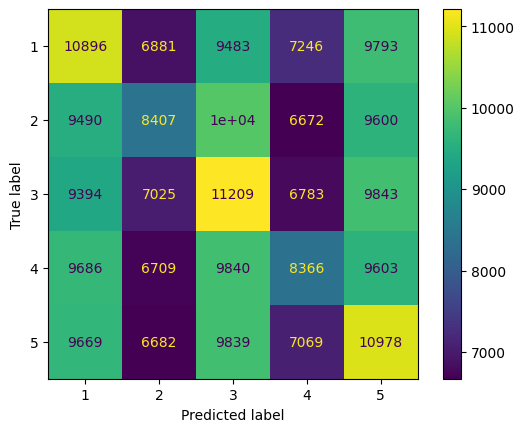

In [58]:
# Mostrar Matriz de Confusão
# Lista ordenada do Target
lista_classes = [1,2,3,4,5]

confusion_matrix_modelo = confusion_matrix(y, y_pred, labels=lista_classes)
disp = ConfusionMatrixDisplay(confusion_matrix_modelo, display_labels=lista_classes)
disp.plot()

## Tuning de Hiperparâmetros

In [63]:
# Com os resultados, concluímos que o dataset é desbalanceado

#  Solução: Ajustar hiperparâmetros do Modelo usando Optuma
# min_samples_leaf = Mínimo de instâncias requerido para formar uma folha (nó terminal) - 20 baseado em artigos
# max_depth = Profundidade máxima da árvore

def decisiontree_optana(trial):
     # Definir parâmetros a serem otimizados
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    max_depth = trial.suggest_int('max_depth', 1, 10)

    #dt_model.set_params(classifier_min_samples_leaf=min_samples_leaf)
    #dt_model.set_params(classifier_max_depth=max_depth)

    dt_model.named_steps['classifier'].set_params(min_samples_leaf=min_samples_leaf, max_depth=max_depth)

    # Avaliar o modelo usando validação cruzada
    scores = cross_val_score(dt_model, X, y, cv=cv_folds, scoring='accuracy')

    return scores.mean()


In [65]:
# Executar a automação dos experimentos
# Objetivo - máxima acurácia (em 100 tentativas)
estudo_decisiontree = optuna.create_study(direction='maximize')
estudo_decisiontree.optimize(decisiontree_optana, n_trials=3)

# 0.21892873426064274 and parameters: {'min_samples_leaf': 15, 'max_depth': 9}
# 3m.1s

[I 2024-02-12 21:02:12,516] A new study created in memory with name: no-name-58a9cb52-30d0-4f88-9656-c4e073b12ea5
[I 2024-02-12 21:03:33,731] Trial 0 finished with value: 0.21892873426064274 and parameters: {'min_samples_leaf': 15, 'max_depth': 9}. Best is trial 0 with value: 0.21892873426064274.
[I 2024-02-12 21:04:13,699] Trial 1 finished with value: 0.20923513293953025 and parameters: {'min_samples_leaf': 1, 'max_depth': 3}. Best is trial 0 with value: 0.21892873426064274.
[I 2024-02-12 21:05:13,661] Trial 2 finished with value: 0.21400055323852848 and parameters: {'min_samples_leaf': 8, 'max_depth': 6}. Best is trial 0 with value: 0.21892873426064274.


In [66]:
# Mostrar melhor resultado e melhor conjunto de hiperparâmetros
print(f'Melhor acurácia: {estudo_decisiontree.best_value}')
print(f'Melhores parâmetros: {estudo_decisiontree.best_params}')

# Melhor acurácia: 0.21892873426064274
# Melhores parâmetros: {'min_samples_leaf': 15, 'max_depth': 9}

Melhor acurácia: 0.21892873426064274
Melhores parâmetros: {'min_samples_leaf': 15, 'max_depth': 9}


# Visualizar Árvore

In [67]:
# Preparar o Conjunto de Dados para treinar e conseguir visualizar a árvore
X_train_tree = X.copy()

# Treinar o modelo com o conjunto de hiperparametro ideal
clf_decisiontree = DecisionTreeClassifier(min_samples_leaf=estudo_decisiontree.best_params['min_samples_leaf'], 
                                          max_depth=estudo_decisiontree.best_params['max_depth'])

y_train_tree = y.copy()

# Árvore pronta para ser treinada
clf_decisiontree.fit(X_train_tree, y_train_tree)

# 35.8s

DecisionTreeClassifier(max_depth=9, min_samples_leaf=15)

[Text(0.4208644278606965, 0.95, '163 <= -0.233\ngini = 0.8\nsamples = 221177\nvalue = [44299, 44183, 44254, 44204, 44237]\nclass = 1'),
 Text(0.16982794361525705, 0.85, '172 <= -0.036\ngini = 0.796\nsamples = 13601\nvalue = [2946, 3290, 2277, 2758, 2330]\nclass = 2'),
 Text(0.04591625207296849, 0.75, '65 <= -0.357\ngini = 0.784\nsamples = 4314\nvalue = [947, 1296, 671, 764, 636]\nclass = 2'),
 Text(0.008291873963515755, 0.65, '56 <= -0.054\ngini = 0.685\nsamples = 276\nvalue = [54.0, 136.0, 28.0, 36.0, 22.0]\nclass = 2'),
 Text(0.003316749585406302, 0.55, '138 <= -0.243\ngini = 0.414\nsamples = 81\nvalue = [9, 61, 3, 4, 4]\nclass = 2'),
 Text(0.001658374792703151, 0.45, 'gini = 0.0\nsamples = 35\nvalue = [0, 35, 0, 0, 0]\nclass = 2'),
 Text(0.004975124378109453, 0.45, '120 <= 0.131\ngini = 0.623\nsamples = 46\nvalue = [9.0, 26.0, 3.0, 4.0, 4.0]\nclass = 2'),
 Text(0.003316749585406302, 0.35, 'gini = 0.743\nsamples = 26\nvalue = [9, 8, 3, 2, 4]\nclass = 1'),
 Text(0.006633499170812604, 

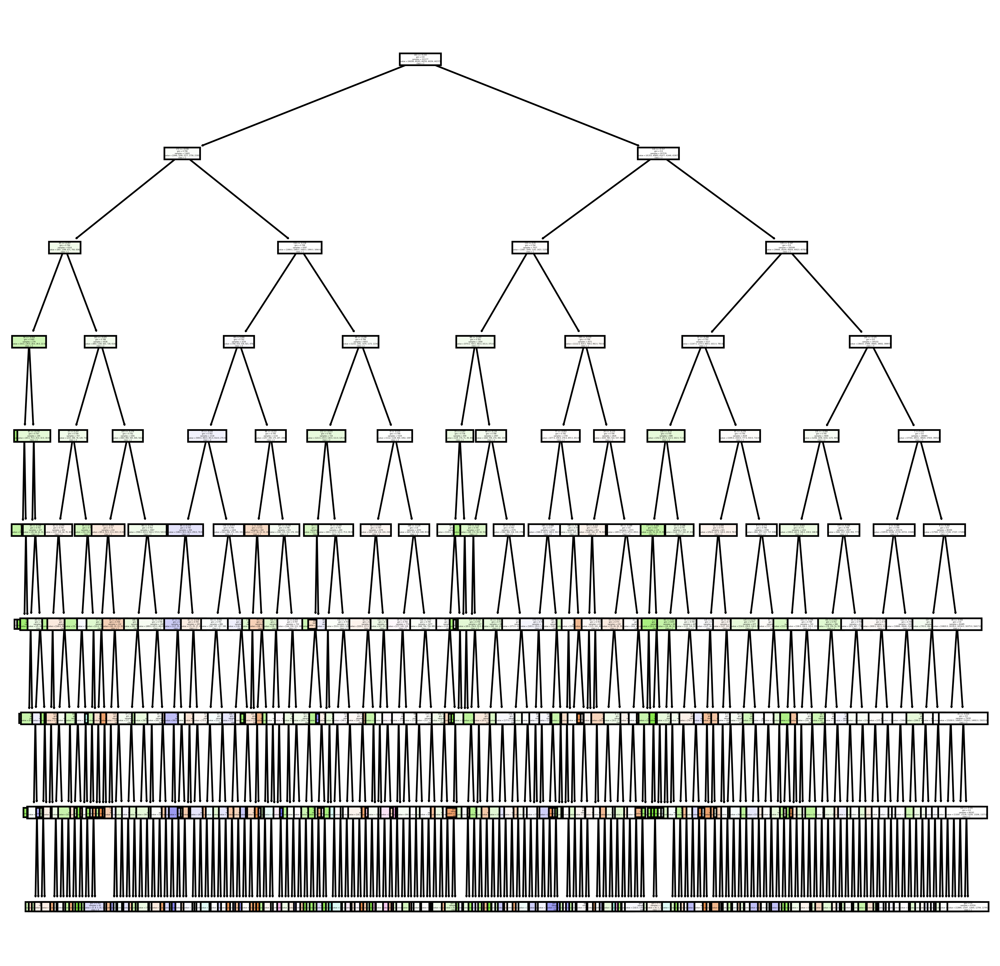

In [69]:
# Converta a lista de classes para strings
lista_classes_str = [str(classe) for classe in lista_classes]

# Visualizar Árvore de Decisão com Plot Tree
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize=(10,10), dpi=600)

plot_tree(clf_decisiontree, 
          feature_names=X_train_tree.columns.to_numpy(), 
          class_names=lista_classes_str,
          filled=True
          )

# Salvar Modelo

In [71]:
import joblib

# Criar um pipeline "tunado"
dt_model_tunado = Pipeline(steps=[('preprocessor', preprocessor),
                                  ('classifier',
                                   DecisionTreeClassifier(
                                       min_samples_leaf=estudo_decisiontree.best_params['min_samples_leaf'],
                                       max_depth=estudo_decisiontree.best_params['max_depth']))])

# Treinar Modelo Tunado
dt_model_tunado.fit(X, y)

# Salvar Modelo
joblib.dump(dt_model_tunado, './modelo_classificacao_tree.pkl')

['./modelo_classificacao_tree.pkl']

# Entrega - App de Predição Batch (por arquivo)

In [73]:
import gradio as gr 

modelo = joblib.load('./modelo_classificacao_tree.pkl')

def predict(arquivo):
    df_empresas = pd.read_csv(arquivo.name)
    y_pred = modelo.predict(df_empresas)
    df_predicao_classes = pd.DataFrame(y_pred, columns=['Classe'])
    df_predicoes = pd.concat([df_predicao_classes, df_empresas], axis=1)
    df_predicao_classes.to_csv('./test/predicoes.csv', index=False)
    return './test/predicoes.csv'

demonstracao = gr.Interface(
    predict, 
    gr.File(file_types=[".csv"]),
    "file"
)

demonstracao.launch()

Running on local URL:  http://127.0.0.1:7861

To create a public link, set `share=True` in `launch()`.
